In [1]:
import tensorflow as tf
import librosa
import kapre
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd
import pandas as pd
import numpy as np
import pathlib
import os
from plotnine import *


In [3]:
data_path = '/tf/Berkeley/W210/dementia/0extra/ADReSS-IS2020-data 2/train'
audio_path_cc = data_path + '/Full_wave_enhanced_audio/cc/'
audio_path_cd = data_path + '/Full_wave_enhanced_audio/cd/'


text_path_cc = data_path + '/transcription/cc/'
text_path_cd = data_path + '/transcription/cd/'

# Meta Data

In [4]:
meta_cc = pd.read_csv(data_path + '/cc_meta_data.txt', sep=";", header=0, 
                      names = ['ID', 'Age', 'Gender', 'MMSE'])
meta_cd = pd.read_csv(data_path + '/cd_meta_data.txt', sep=";", header=0, 
                      names = ['ID', 'Age', 'Gender', 'MMSE'])

meta = meta_cc.assign(Group = 'cc').append(meta_cd.assign(Group = 'cd')).reset_index()

meta

,index,ID,Age,Gender,MMSE,Group
0,0,S001,74,male,NA,cc
1,1,S002,62,female,30,cc
2,2,S003,69,female,29,cc
3,3,S004,71,female,30,cc
4,4,S005,74,female,30,cc
...,...,...,...,...,...,...
103,49,S150,58,male,20,cd
104,50,S151,72,male,24,cd
105,51,S153,68,female,12,cd
106,52,S154,65,female,20,cd


108 samples are not a lot. 

In [5]:
sum(meta.MMSE == ' NA')

1

In [6]:
meta.MMSE = pd.to_numeric(meta.MMSE.replace(' NA', 30))

In [7]:
meta.dtypes

index      int64
ID        object
Age        int64
Gender    object
MMSE       int64
Group     object
dtype: object

* Age is quite balanced by gender

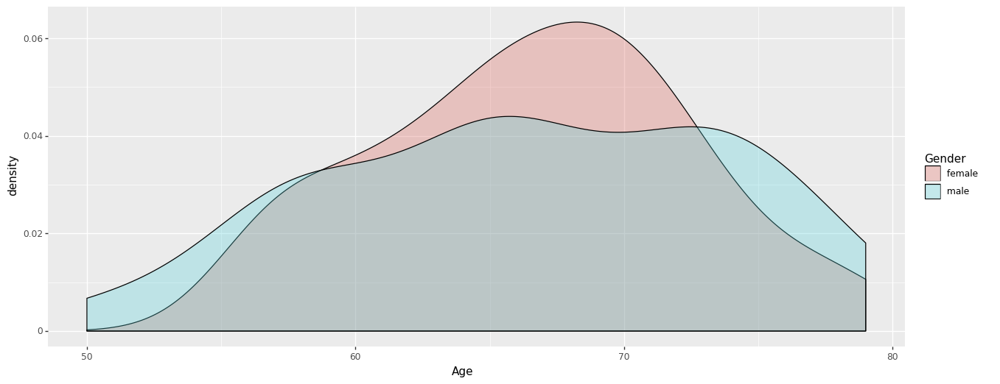

<ggplot: (-9223363253365525525)>

In [9]:
ggplot(meta) + geom_density(aes(x = 'Age', fill = 'Gender'), alpha = .3) + theme(figure_size = (15, 6))

* Age is also quite balanced by group

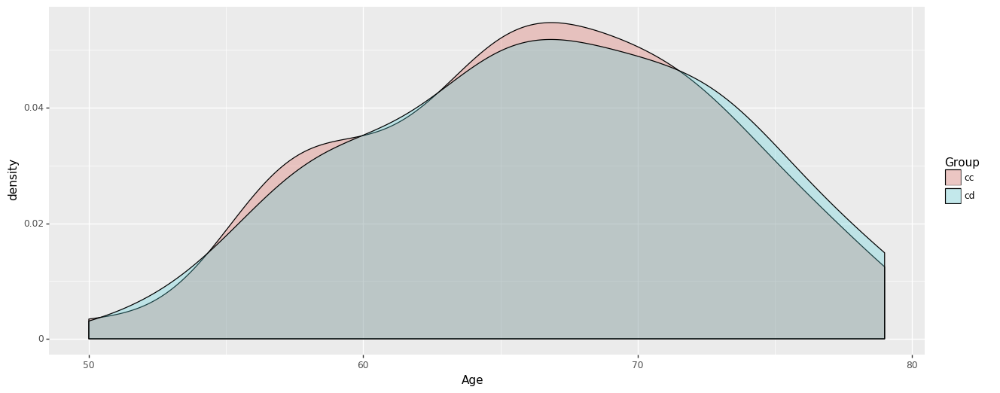

<ggplot: (-9223363253365525595)>

In [10]:
ggplot(meta) + geom_density(aes(x = 'Age', fill = 'Group'), alpha = .3) + theme(figure_size = (15, 6))

* 24 is a very good cutoff, we might push it just a bit higher to lower the false negatives but that's very sample specific.

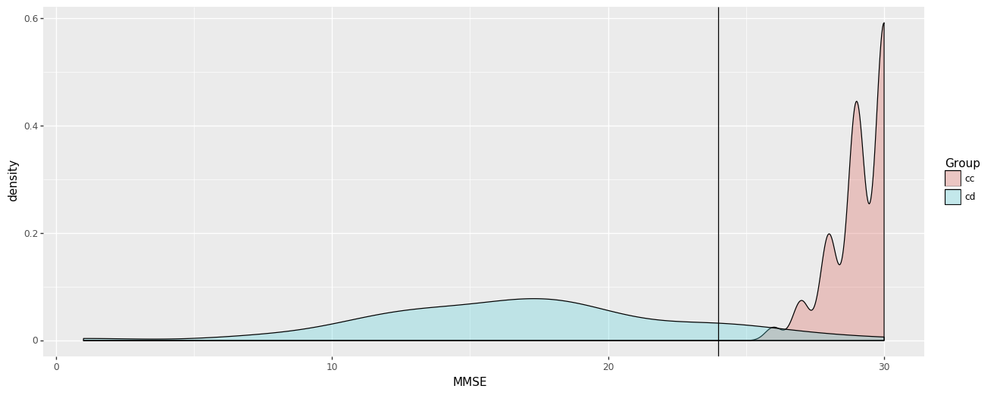

<ggplot: (8743241108954)>

In [99]:
ggplot(meta) + geom_density(aes(x = 'MMSE', fill = 'Group'), alpha = .3) + theme(figure_size = (15, 6)) + geom_vline(xintercept = 24)

# Visualize the audio data

In [100]:
audio_path_cc

'/tf/Berkeley/W210/dementia/0extra/ADReSS-IS2020-data 2/train/Full_wave_enhanced_audio/cc/'

In [101]:
x_cc, sr_cc = librosa.load(audio_path_cc + 'S001.wav')    # MMSE 30
x_cd, sr_cd = librosa.load(audio_path_cd + 'S079.wav')    # MMSE 18

In [115]:
x_cc.shape[0]/sr_cc # this is the length in seconds

88.86231292517007

In [102]:
print(x_cc.shape)
print(sr_cc)

(1959414,)
22050


In [103]:
print(x_cd.shape)
print(sr_cd)

(1792450,)
22050


In [104]:
meta.query('ID == "S002 "')

,index,ID,Age,Gender,MMSE,Group
1,1,S002,62,female,30,cc


In [105]:
meta.query('ID == "S079 "')

,index,ID,Age,Gender,MMSE,Group
54,0,S079,59,male,11,cd


Text(0.5, 1.0, 'Dementia: MMSE 11')

<Figure size 432x288 with 0 Axes>

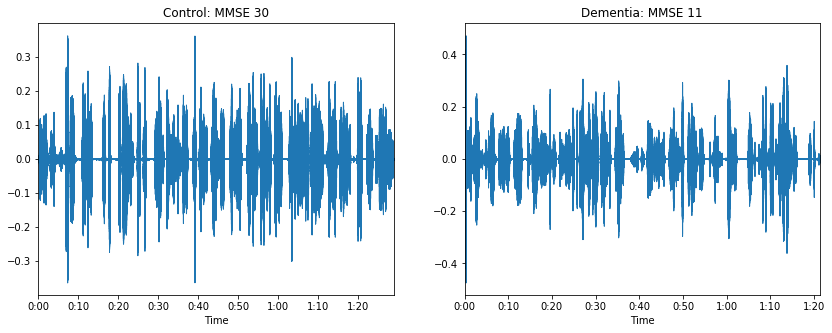

In [106]:
# Waveform plot
plt.figure()
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
librosa.display.waveplot(x_cc, sr=sr_cc)
plt.title('Control: MMSE 30')
plt.subplot(1, 2, 2)
librosa.display.waveplot(x_cd, sr=sr_cd)
plt.title('Dementia: MMSE 11')


Text(0.5, 1.0, 'Dementia: MMSE 11')

<Figure size 432x288 with 0 Axes>

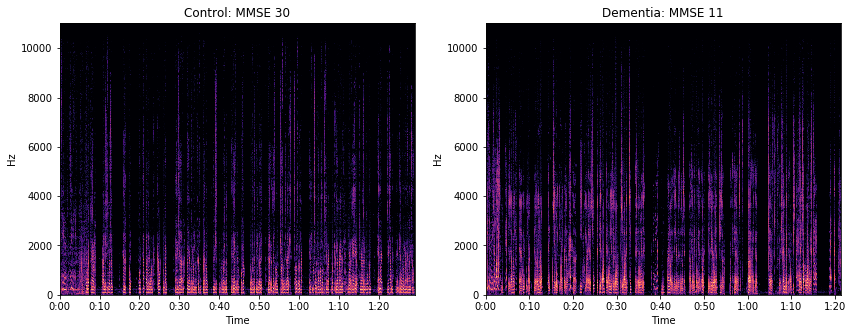

In [107]:
# spectrogram plot
plt.figure()
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
librosa.display.specshow(librosa.amplitude_to_db(abs(librosa.stft(x_cc))), sr=sr_cc, x_axis='time', y_axis='hz')
plt.title('Control: MMSE 30')

plt.subplot(1, 2, 2)
librosa.display.specshow(librosa.amplitude_to_db(abs(librosa.stft(x_cd))), sr=sr_cc, x_axis='time', y_axis='hz')
plt.title('Dementia: MMSE 11')

In [108]:
ipd.Audio(audio_path_cc + 'S001.wav')    # MMSE 30

In [109]:
ipd.Audio(audio_path_cd + 'S079.wav') # MMSE 11

In [111]:
meta.sort_values('MMSE')

,index,ID,Age,Gender,MMSE,Group
77,23,S111,66,female,1,cd
61,7,S087,70,female,7,cd
63,9,S090,59,male,8,cd
80,26,S118,77,female,10,cd
57,3,S082,66,male,11,cd
...,...,...,...,...,...,...
33,33,S043,69,male,30,cc
35,35,S049,65,male,30,cc
41,41,S059,57,female,30,cc
39,39,S056,68,female,30,cc


In [112]:
ipd.Audio(audio_path_cd + 'S111.wav') # MMSE 11

# Looking into chuncks

In [68]:
meta = meta.assign(length = 0, chunks = 0, chunk_length = 0)


In [69]:
audio_chuck_path = '/tf/Berkeley/W210/dementia/0extra/ADReSS-IS2020-data 2/train/Normalised_audio-chunks/'
filenames = tf.io.gfile.glob(str(audio_chuck_path) + '*/*')
ID_list = list(map(lambda filename:filename.split('/')[-1].split('-')[0], filenames))


In [70]:
def get_length(path):
    x, sr = librosa.load(path)
    return x.shape[0]/sr

In [71]:
for i in range(meta.shape[0]):
    ID = meta.ID[i][0:4]
    group = meta.Group[i]
    if group == 'cc':
        path = audio_path_cc + ID + '.wav'
    else:
        path = audio_path_cd + ID + '.wav'
                
    meta.at[i, 'length'] = get_length(path)
    meta.at[i, 'chunks'] = ID_list.count(ID)
    ID_chunks = [filenames[i] for i, val in enumerate(ID_list) if val == ID]
    meta.at[i, 'chunk_length'] = sum(list(map(get_length, ID_chunks)))

    

In [33]:
meta['portion'] = meta['chunks']/meta['length']

/usr/local/lib/python3.6/dist-packages/plotnine/facets/facet.py:552: PlotnineWarning: If you need more space for the x-axis tick text use ... + theme(subplots_adjust={'wspace': 0.25}). Choose an appropriate value for 'wspace'.
/usr/local/lib/python3.6/dist-packages/plotnine/facets/facet.py:558: PlotnineWarning: If you need more space for the y-axis tick text use ... + theme(subplots_adjust={'hspace': 0.25}). Choose an appropriate value for 'hspace'


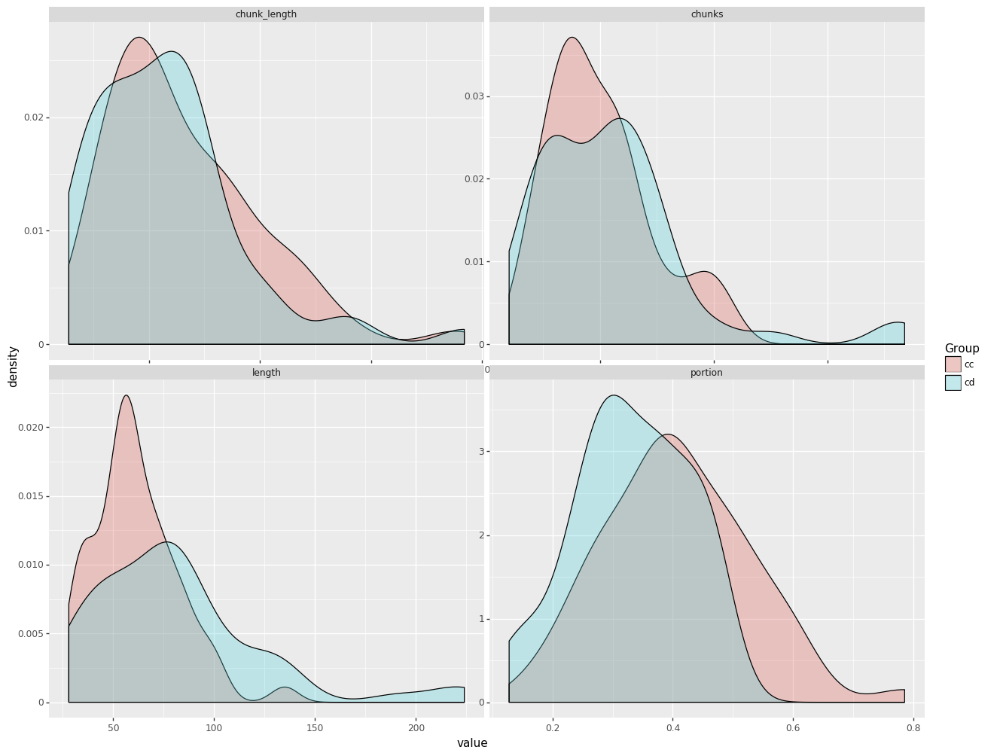

<ggplot: (-9223363253307554360)>

In [73]:
ggplot(pd.melt(meta, id_vars = 'Group', value_vars = ['length', 'chunks', 'portion', 'chunk_length'])) + \
geom_density(aes(x = 'value', fill = 'Group'), alpha = .3) + facet_wrap('variable', scales = 'free') + \
theme(figure_size = (15, 12))

# Baseline 

In [8]:
import tensorflow as tf

from tensorflow.keras.layers.experimental import preprocessing
from tensorflow.keras import layers
from tensorflow.keras import models
seed = 30
tf.random.set_seed(seed)
np.random.seed(seed)

In [315]:
data_dir = pathlib.Path('/tf/Berkeley/W210/dementia/0extra/ADReSS-IS2020-data 2/train/Full_wave_enhanced_audio/')
filenames = tf.random.shuffle(tf.io.gfile.glob(str(data_dir) + '/*/*'))

train_cutoff = int(len(filenames)*0.7)
val_cutoff = int(len(filenames)*0.85)

train_files = filenames[:train_cutoff]
val_files = filenames[train_cutoff:val_cutoff]
test_files = filenames[val_cutoff:]

In [316]:
def decode_audio(audio_binary):
    audio, _ = tf.audio.decode_wav(audio_binary)
    return tf.squeeze(audio, axis=-1)

def get_label(file_path):
    meta_cc = pd.read_csv(data_path + '/cc_meta_data.txt', sep=";", header=0, 
                      names = ['ID', 'Age', 'Gender', 'MMSE'])
    meta_cd = pd.read_csv(data_path + '/cd_meta_data.txt', sep=";", header=0, 
                          names = ['ID', 'Age', 'Gender', 'MMSE'])

    meta = meta_cc.assign(Group = 'cc').append(meta_cd.assign(Group = 'cd')).reset_index()
    meta.MMSE = pd.to_numeric(meta.MMSE.replace(' NA', 30))
    
    name = tf.strings.split(tf.strings.split(file_path, os.path.sep)[-1], '.')[0]
    label = meta.MMSE[meta.ID == name + ' ']
    return label.tolist()

def get_waveform_and_label(file_path):
    label = get_label(file_path)
    audio_binary = tf.io.read_file(file_path)
    waveform = decode_audio(audio_binary)
    return waveform, label

def get_spectrogram(waveform):
    # Padding for files with less than 16000 samples
    zero_padding = tf.zeros([10000000] - tf.shape(waveform), dtype=tf.float32)

    # Concatenate audio with padding so that all audio clips will be of the 
    # same length
    waveform = tf.cast(waveform, tf.float32)
    equal_length = tf.concat([waveform, zero_padding], 0)
    
    spectrogram = tf.signal.stft(equal_length, frame_length=255, frame_step=128)
    spectrogram = tf.abs(spectrogram)

    return spectrogram

def get_spectrogram_and_label_id(audio, label):
    spectrogram = get_spectrogram(audio)
    spectrogram = tf.expand_dims(spectrogram, -1)
    return spectrogram, label

In [782]:
def get_data(file_path):

#     meta_cc = pd.read_csv(data_path + '/cc_meta_data.txt', sep=";", header=0, 
#                       names = ['ID', 'Age', 'Gender', 'MMSE'])
#     meta_cd = pd.read_csv(data_path + '/cd_meta_data.txt', sep=";", header=0, 
#                           names = ['ID', 'Age', 'Gender', 'MMSE'])
#     meta = meta_cc.assign(Group = 'cc').append(meta_cd.assign(Group = 'cd')).reset_index()
#     meta.MMSE = pd.to_numeric(meta.MMSE.replace(' NA', 30))
    
    names = meta.ID
    name = tf.strings.split(tf.strings.split(file_path, os.path.sep)[-1], '.')[0] + ' '
    label = tf.gather(meta.MMSE, tf.where(tf.equal(names, name))[0][0])
    audio_binary = tf.io.read_file(file_path)
    waveform = decode_audio(audio_binary)
    
    zero_padding = tf.zeros([10000000] - tf.shape(waveform), dtype=tf.float32)
    waveform = tf.cast(waveform, tf.float32)
    equal_length = tf.concat([waveform, zero_padding], 0)
    
    spectrogram = tf.signal.stft(equal_length, frame_length=255, frame_step=128)
    spectrogram = tf.abs(spectrogram)
    spectrogram = tf.expand_dims(spectrogram, -1)
    return spectrogram, label

In [783]:
AUTOTUNE = tf.data.AUTOTUNE

def preprocess_dataset(files):
    files_ds = tf.data.Dataset.from_tensor_slices(files)
    output_ds = files_ds.map(get_data, num_parallel_calls=AUTOTUNE)
    return output_ds


In [784]:
train_ds = preprocess_dataset(train_files)
val_ds = preprocess_dataset(val_files)
test_ds = preprocess_dataset(test_files)

In [785]:
for spectrogram, x in train_ds.take(1):
    input_shape = spectrogram.shape
    print(input_shape)
    print(x)


(78124, 129, 1)
tf.Tensor(30.0, shape=(), dtype=float64)


In [786]:
batch_size = 64
train_ds = train_ds.batch(batch_size)
val_ds = val_ds.batch(batch_size)

In [787]:
train_ds = train_ds.cache().prefetch(AUTOTUNE)
val_ds = val_ds.cache().prefetch(AUTOTUNE)

In [804]:
print('Input shape:', input_shape)

norm_layer = preprocessing.Normalization()
norm_layer.adapt(train_ds.map(lambda x, _: x))

model = models.Sequential([
    layers.Input(shape=input_shape),
    preprocessing.Resizing(32, 32), 
    norm_layer,
    layers.Conv2D(32, 3, activation='relu'),
#     layers.Conv2D(64, 3, activation='relu'),
    layers.MaxPooling2D(),
    layers.Dropout(0.25),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1)
])

model.summary()

Input shape: (78124, 129, 1)
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resizing_2 (Resizing)        (None, 32, 32, 1)         0         
_________________________________________________________________
normalization_2 (Normalizati (None, 32, 32, 1)         3         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 30, 30, 32)        320       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 15, 15, 32)        0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 15, 15, 32)        0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 7200)              0         
_________________________________________________________________
dense_4 (Dense)          

In [805]:
model.compile(
    optimizer="adam",
    loss='mse',
    metrics=[tf.keras.losses.MeanSquaredError()]
)

In [806]:
EPOCHS = 100
history = model.fit(
    train_ds, 
    validation_data=val_ds,  
    epochs=EPOCHS
)

Epoch 1/100
2/2 [==============================] - 10s 6s/step - loss: 576.4831 - mean_squared_error: 565.7858 - val_loss: 643.5175 - val_mean_squared_error: 643.5175
Epoch 2/100
2/2 [==============================] - 1s 527ms/step - loss: 526.5410 - mean_squared_error: 519.6129 - val_loss: 599.7092 - val_mean_squared_error: 599.7092
Epoch 3/100
2/2 [==============================] - 1s 242ms/step - loss: 458.3239 - mean_squared_error: 451.9937 - val_loss: 547.0947 - val_mean_squared_error: 547.0947
Epoch 4/100
2/2 [==============================] - 0s 262ms/step - loss: 405.8851 - mean_squared_error: 404.4200 - val_loss: 485.9724 - val_mean_squared_error: 485.9724
Epoch 5/100
2/2 [==============================] - 1s 218ms/step - loss: 343.3269 - mean_squared_error: 337.6569 - val_loss: 417.1908 - val_mean_squared_error: 417.1908
Epoch 6/100
2/2 [==============================] - 0s 200ms/step - loss: 284.0601 - mean_squared_error: 280.0304 - val_loss: 343.1074 - val_mean_squared_erro

2/2 [==============================] - 0s 210ms/step - loss: 55.4365 - mean_squared_error: 55.1945 - val_loss: 47.3733 - val_mean_squared_error: 47.3733
Epoch 51/100
2/2 [==============================] - 0s 180ms/step - loss: 47.2216 - mean_squared_error: 48.5291 - val_loss: 47.9855 - val_mean_squared_error: 47.9855
Epoch 52/100
2/2 [==============================] - 0s 205ms/step - loss: 48.7998 - mean_squared_error: 49.6424 - val_loss: 48.3271 - val_mean_squared_error: 48.3271
Epoch 53/100
2/2 [==============================] - 0s 158ms/step - loss: 48.5336 - mean_squared_error: 46.4671 - val_loss: 48.9647 - val_mean_squared_error: 48.9647
Epoch 54/100
2/2 [==============================] - 0s 207ms/step - loss: 68.1524 - mean_squared_error: 68.5449 - val_loss: 49.8356 - val_mean_squared_error: 49.8356
Epoch 55/100
2/2 [==============================] - 0s 176ms/step - loss: 70.2230 - mean_squared_error: 78.9717 - val_loss: 51.8307 - val_mean_squared_error: 51.8307
Epoch 56/100
2/2 

2/2 [==============================] - 0s 120ms/step - loss: 52.1209 - mean_squared_error: 50.3592 - val_loss: 50.2908 - val_mean_squared_error: 50.2908
Epoch 100/100
2/2 [==============================] - 0s 126ms/step - loss: 46.4442 - mean_squared_error: 41.8106 - val_loss: 46.2528 - val_mean_squared_error: 46.2528


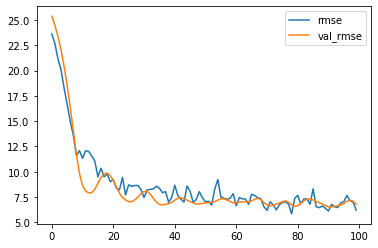

In [807]:
metrics = history.history
plt.plot(history.epoch, np.sqrt(metrics['mean_squared_error']), np.sqrt(metrics['val_mean_squared_error']))
plt.legend(['rmse', 'val_rmse'])
plt.show()

In [810]:
test_files.shape

TensorShape([17])